# Sentiment Analysis: A Logistic Regression Approach
Sentiment analysis project, it is a technique that detects the underlying sentiment in a piece of text. Classifying text as either positive, negative, or neutral.




## Load Dataset

In [2]:
from google.colab import drive
import pandas as pd

In [3]:
drive.mount('/content/gdrive')

Mounted at /content/gdrive


### Read The Dataframe

We will be using the Reviews.csv file from Kaggle’s Amazon Fine Food Reviews dataset to perform the analysis.

The data that we will be using most for this analysis is “Summary”, “Text”, and “Score.”
 

Text — This variable contains the complete product review information. 


 Summary — This is a summary of the entire review. 


Score — The product rating provided by the customer.

In [4]:
# step1: Read the Dataframe
df = pd.read_csv(r'/content/gdrive/MyDrive/Colab Notebooks/Reviews.csv')

In [5]:
df.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...


## Data Analysis


we will take a look at the variable “Score” to see if majority of the customer ratings are positive or negative. we use Graphical Analysis and Display of Data.

In [6]:
#step 2: Data Analysis
# Imports
import matplotlib.pyplot as plt
import seaborn as sns
color = sns.color_palette()
%matplotlib inline
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import plotly.express as px
# Product Scores
fig = px.histogram(df, x="Score")
fig.update_traces(marker_color="turquoise",marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5)
fig.update_layout(title_text='Product Score')
fig.show()

### Creat WordClouds

we create some wordclouds to see the most frequently used words in the reviews:

In [7]:
!pip install wordcloud

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


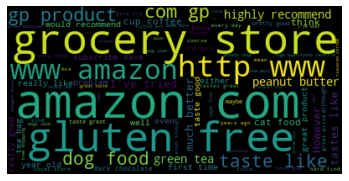

In [8]:
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords 
from wordcloud import WordCloud
# Create stopword list:
STOPWORDS = stopwords.words('english')
stopwords = set(STOPWORDS) 
stopwords.update(["br", "href"])
textt = " ".join(review for review in df.Text)
wordcloud = WordCloud(stopwords=stopwords).generate(textt)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.savefig('wordcloud11.png')
plt.show()

### Classifying Tweets


We will classify reviews into “positive” as +1 and “negative” as -1.
Score’ > 3 as +1,  ‘Score’ = 3 will be dropped, and  ‘Score’ < 3 as -1.

In [9]:
#Step 3: Classifying Tweets
# assign reviews with score > 3 as positive sentiment
# score < 3 negative sentiment
# remove score = 3
df = df[df['Score'] != 3]
df['sentiment'] = df['Score'].apply(lambda rating : +1 if rating > 3 else -1)

###  More Data Analysis 

We will create two data frames — one with all the positive reviews, and another with all the negative reviews.

In [10]:
#Step 4: More Data Analysis
# split df - positive and negative sentiment:
positive = df[df['sentiment'] == 1]
negative = df[df['sentiment'] == -1]

#### WordCloud — Positive Sentiment :

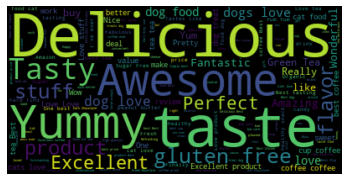

In [11]:
stopwords = set(STOPWORDS)
stopwords.update(["br", "href","good","great"]) 
## good and great removed because they were included in negative sentiment
pos = " ".join(review for review in positive.Summary)
wordcloud2 = WordCloud(stopwords=stopwords).generate(pos)
plt.imshow(wordcloud2, interpolation='bilinear')
plt.axis("off")
plt.show()

#### Wordcloud — Negative Sentiment:

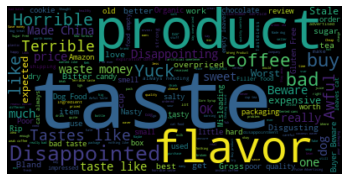

In [12]:
neg = " ".join(str(review) for review in negative.Summary)
wordcloud3 = WordCloud(stopwords=stopwords).generate(neg)
plt.imshow(wordcloud3, interpolation='bilinear')
plt.axis("off")
plt.savefig('wordcloud33.png')
plt.show()

### Look At The Distribution Of Reviews

we can take a look at the distribution of reviews with sentiment across the dataset:

In [13]:
!pip install -U kaleido

     |████████████████████████████████| 79.9 MB 129 kB/s 


In [14]:
df['sentimentt'] = df['sentiment'].replace({-1 : 'negative'})
df['sentimentt'] = df['sentimentt'].replace({1 : 'positive'})
fig = px.histogram(df, x="sentimentt")
fig.update_traces(marker_color="indianred",marker_line_color='rgb(8,48,107)',
                  marker_line_width=1.5)
fig.update_layout(title_text='Product Sentiment')
py.plot(fig, filename='lifeExp.html')
fig.show()

## Building The Model

This is a classification task, so we will train a simple logistic regression model to do it.

There are a few steps we need to take:

### Data Cleaning

We will be using the summary data to come up with predictions. First, we need to remove all punctuation from the data.

In [15]:
#Step 5: Building the Model
def remove_punctuation(text):
    final = "".join(u for u in text if u not in ("?", ".", ";", ":",  "!",'"'))
    return final
df['Text'] = df['Text'].apply(remove_punctuation)
df = df.dropna(subset=['Summary']) #removes nan/null values in summary column
df['Summary'] = df['Summary'].apply(remove_punctuation)

### Split The DataFrame

The new data frame should only have two columns — “Summary” (the review text data), and “sentiment” (the target variable).


In [16]:
dfNew = df[['Summary', 'sentiment']]
dfNew.head()

,Summary,sentiment
0,Good Quality Dog Food,1
1,Not as Advertised,-1
2,Delight says it all,1
3,Cough Medicine,-1
4,Great taffy,1


#### Train and Test Splitting

Split the data frame into train:80%, and test:20%, sets :

In [17]:
# random split train and test data
import numpy as np
index = df.index
df['random_number'] = np.random.randn(len(index))
train = df[df['random_number'] <= 0.8]
test = df[df['random_number'] > 0.8]

### Creat a Bag Of Words

use a count vectorizer from the Scikit-learn library.
This will transform the text in our data frame into a bag of words model, which will contain a sparse matrix of integers. The number of occurrences of each word will be counted and printed.

In [18]:
# Count Vectorizer:
from sklearn.feature_extraction.text import CountVectorizer
vectorizer = CountVectorizer(token_pattern=r'\b\w+\b')
train_matrix = vectorizer.fit_transform(train['Summary'])
test_matrix = vectorizer.transform(test['Summary'])

### Logistic Regression 

#### Import Logistic Regression

In [19]:
# Logistic Regression
from sklearn.linear_model import LogisticRegression
lr = LogisticRegression()

#### Split Target And Independent Variables 

In [20]:
X_train = train_matrix 
X_test = test_matrix 
y_train = train['sentiment']
y_test = test['sentiment']

#### Fit Model On Data

In [21]:
lr.fit(X_train, y_train)

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)

#### Make Predictions

In [22]:
predictions = lr.predict(X_test)

#### Testing

In [23]:
# Step 6: Testing
# find accuracy, precision, recall:
from sklearn.metrics import confusion_matrix, classification_report
new = np.asarray(y_test)
confusion_matrix(y_true=y_test, y_pred=predictions)

array([[11542,  5956],
       [ 2380, 91573]])

In [24]:
print(classification_report(y_test, predictions))

              precision    recall  f1-score   support

          -1       0.83      0.66      0.73     17498
           1       0.94      0.97      0.96     93953

    accuracy                           0.93    111451
   macro avg       0.88      0.82      0.85    111451
weighted avg       0.92      0.93      0.92    111451



And It's Done! ^__^